# DLIB Face Recognition

* [Face Recognition](https://github.com/ageitgey/face_recognition)

Recognize and manipulate faces from Python or from the command line with the world's simplest face recognition library. Built using [dlib](http://dlib.net/)'s state-of-the-art face recognition built with deep learning. The model has an accuracy of 99.38% on the [Labeled Faces in the Wild](http://vis-www.cs.umass.edu/lfw/) benchmark.

In [ ]:
!pip install face_recognition

In [1]:
import face_recognition
import numpy as np

In [3]:
img_bobby ="faces/bobbie_w_draper.jpg"
img_jim ="faces/jim_holden.jpg"
img_amos ="faces/amos_burton.jpg"
img_camina ="faces/camina_drummer.jpg"
img_naomi ="faces/naomi_nagata.jpg"
img_chrisjen ="faces/chrisjen_avasarala.jpg"

image_path = img_bobby

## Detect Face Location (CPU)

Re-run the following steps for all training images above:

In [4]:
image = face_recognition.load_image_file(image_path)
face_locations = face_recognition.face_locations(image)

### Crop Location

In [2]:
import cv2 as cv
import matplotlib.pyplot as plt

In [6]:
img = cv.imread(image_path)
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)

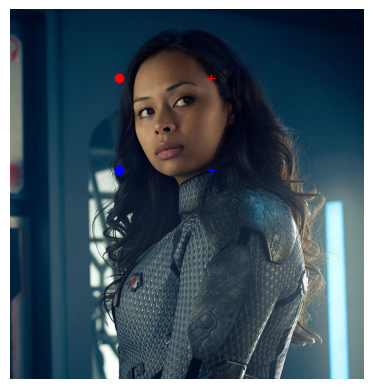

In [8]:
plt.imshow(img)
plt.axis('off')

for face_location in face_locations:  
    plt.plot(face_location[3], face_location[0], 'ro') 
    plt.plot(face_location[1], face_location[0], 'r+')     
    plt.plot(face_location[3], face_location[2], 'bo')
    plt.plot(face_location[1], face_location[2], 'b+')

plt.show()

In [9]:
for face_location in face_locations: 
    x1, y1 = face_location[3], face_location[2]
    x2, y2 = face_location[1], face_location[2]
    x3, y3 = face_location[1], face_location[0]
    x4, y4 = face_location[3], face_location[0]

top_left_x = min([x1,x2,x3,x4])
top_left_y = min([y1,y2,y3,y4])
bot_right_x = max([x1,x2,x3,x4])
bot_right_y = max([y1,y2,y3,y4])

cropped_image = img[top_left_y:bot_right_y, top_left_x:bot_right_x]

(-0.5, 267.5, 266.5, -0.5)

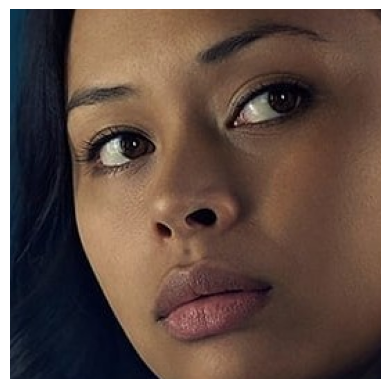

In [10]:
plt.imshow(cropped_image)
plt.axis('off')

In [11]:
cv.imwrite('faces/cut/bobbie_w_draper.jpg', cv.cvtColor(cropped_image, cv.COLOR_RGB2BGR))

True

### Get all the Training Images

In [29]:
bobby_train = face_recognition.load_image_file(img_bobby)
jim_train = face_recognition.load_image_file(img_jim)
amos_train = face_recognition.load_image_file(img_amos)
camina_train = face_recognition.load_image_file(img_camina)
naomi_train = face_recognition.load_image_file(img_naomi)
chrisjen_train = face_recognition.load_image_file(img_chrisjen)

bobby_encoding = face_recognition.face_encodings(bobby_train)[0]
jim_encoding = face_recognition.face_encodings(jim_train)[0]
amos_encoding = face_recognition.face_encodings(amos_train)[0]
camina_encoding = face_recognition.face_encodings(camina_train)[0]
naomi_encoding = face_recognition.face_encodings(naomi_train)[0]
chrisjen_encoding = face_recognition.face_encodings(chrisjen_train)[0]

In [4]:
from glob import glob

cropped_images = glob('./faces/cut/*.jpg')

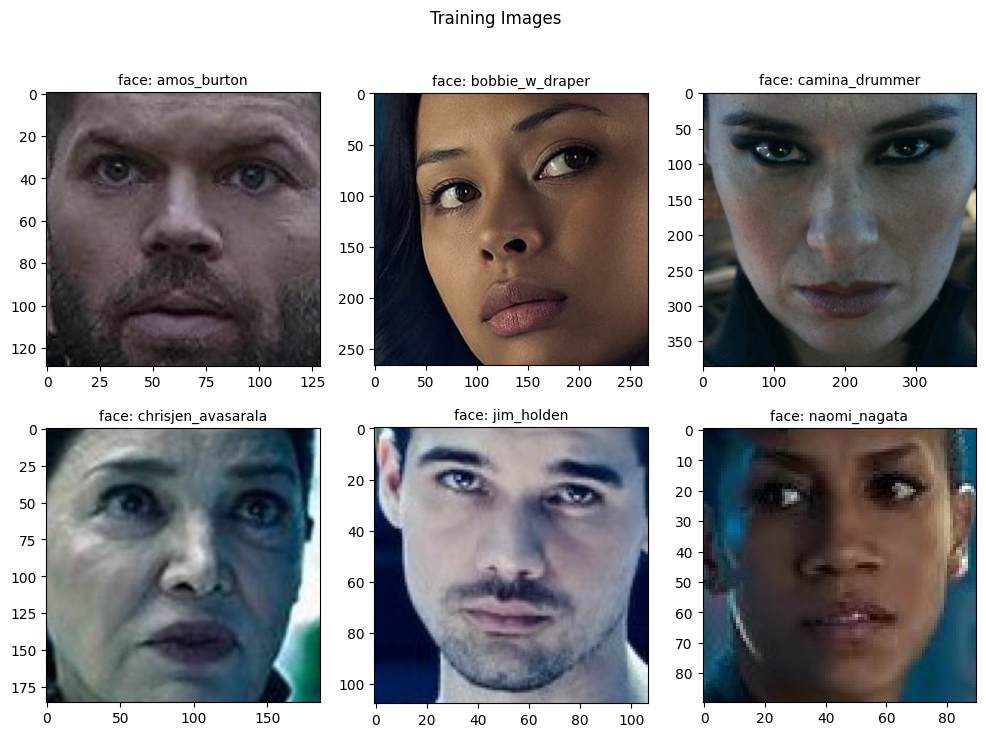

In [31]:
plt.figure(figsize=(12, 8))
plt.suptitle('Training Images')

ax = plt.subplot(2, 3, 1)
img_path = cropped_images[0]
img_title = 'face: ' + cropped_images[0][12:-4]
plt.title(img_title, fontsize='medium')
image = plt.imread(img_path)
plt.imshow(image, cmap=plt.cm.binary)

ax = plt.subplot(2, 3, 2)
img_path = cropped_images[1]
img_title = 'face: ' + cropped_images[1][12:-4]
plt.title(img_title, fontsize='medium')
image = plt.imread(img_path)
plt.imshow(image, cmap=plt.cm.binary)

ax = plt.subplot(2, 3, 3)
img_path = cropped_images[2]
img_title = 'face: ' + cropped_images[2][12:-4]
plt.title(img_title, fontsize='medium')
image = plt.imread(img_path)
plt.imshow(image, cmap=plt.cm.binary)

ax = plt.subplot(2, 3, 4)
img_path = cropped_images[3]
img_title = 'face: ' + cropped_images[3][12:-4]
plt.title(img_title, fontsize='medium')
image = plt.imread(img_path)
plt.imshow(image, cmap=plt.cm.binary)

ax = plt.subplot(2, 3, 5)
img_path = cropped_images[4]
img_title = 'face: ' + cropped_images[4][12:-4]
plt.title(img_title, fontsize='medium')
image = plt.imread(img_path)
plt.imshow(image, cmap=plt.cm.binary)

ax = plt.subplot(2, 3, 6)
img_path = cropped_images[5]
img_title = 'face: ' + cropped_images[5][12:-4]
plt.title(img_title, fontsize='medium')
image = plt.imread(img_path)
plt.imshow(image, cmap=plt.cm.binary)

## Face Recognition

Loading a bunch of test images with "unknown" faces:

In [14]:
test_image1 = face_recognition.load_image_file("faces/test/unknown_01.jpg")
test_image2 = face_recognition.load_image_file("faces/test/unknown_02.jpg")
test_image3 = face_recognition.load_image_file("faces/test/unknown_03.jpg")
test_image4 = face_recognition.load_image_file("faces/test/unknown_04.jpg")
test_image5 = face_recognition.load_image_file("faces/test/unknown_05.jpg")
test_image6 = face_recognition.load_image_file("faces/test/unknown_06.jpg")

test1_encoding = face_recognition.face_encodings(test_image1)
test2_encoding = face_recognition.face_encodings(test_image2)
test3_encoding = face_recognition.face_encodings(test_image3)
test4_encoding = face_recognition.face_encodings(test_image4)
test5_encoding = face_recognition.face_encodings(test_image5)
test6_encoding = face_recognition.face_encodings(test_image6)

### Compare Faces

Compare all detected images in the test dataset to the training images:

In [75]:
trained_images = [bobby_encoding, jim_encoding, amos_encoding, camina_encoding, naomi_encoding, chrisjen_encoding]
trained_faces = np.array(["bobbie_w_draper", "jim_holden", "amos_burton", "camina_drummer", "naomi_nagata", "chrisjen_avasarala"])

#### Test Image 1

In [132]:
test1_results = []

for detection in test1_encoding:
    result = face_recognition.compare_faces(trained_images, detection)
    test1_results.append(trained_faces[result])

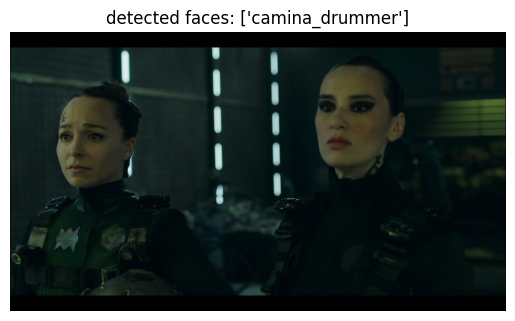

In [133]:
test_img1 = plt.imread('faces/test/unknown_01.jpg')
plt.title('detected faces: \n' + str(test1_results), fontsize='small')
plt.axis('off')
plt.imshow(test_img1)

#### Test Image 2

In [130]:
test2_results = []

for detection in test2_encoding:
    result = face_recognition.compare_faces(trained_images, detection)
    test1_results.append(trained_faces[result])

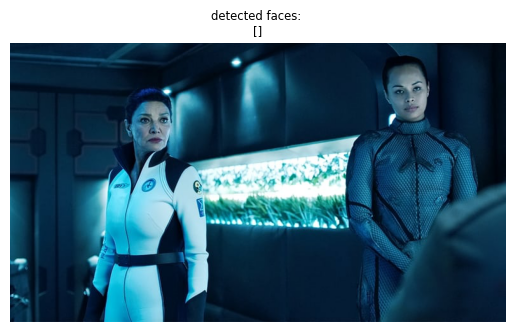

In [131]:
test_img2 = plt.imread('faces/test/unknown_02.jpg')
plt.title('detected faces: \n' + str(test2_results), fontsize='small')
plt.axis('off')
plt.imshow(test_img2)

#### Test Image 3

In [127]:
test3_results = []

for detection in test3_encoding:
    result = face_recognition.compare_faces(trained_images, detection)
    test3_results.append(trained_faces[result])

test3_results

[array(['naomi_nagata'], dtype='<U18'), array(['amos_burton'], dtype='<U18')]

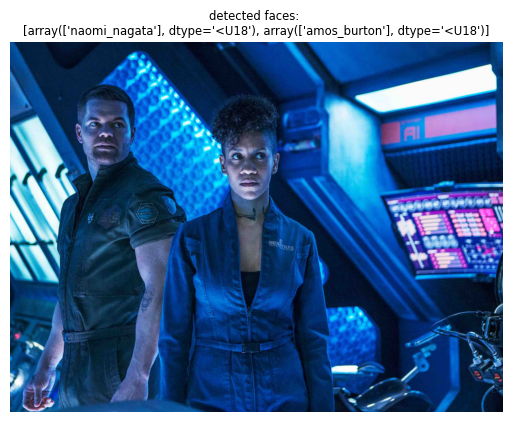

In [128]:
test_img3 = plt.imread('faces/test/unknown_03.jpg')
plt.title('detected faces: \n' + str(test3_results), fontsize='small')
plt.axis('off')
plt.imshow(test_img3)

#### Test Image 4

In [118]:
test4_results = []

for detection in test4_encoding:
    result = face_recognition.compare_faces(trained_images, detection)
    test4_results.append(trained_faces[result])

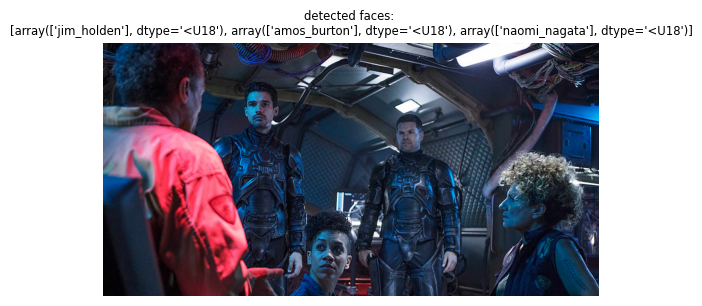

In [125]:
test_img4 = plt.imread('faces/test/unknown_04.jpg')
plt.title('detected faces: \n' + str(test4_results), fontsize='small')
plt.axis('off')
plt.imshow(test_img4)

#### Test Image 5

In [136]:
test5_results = []

for detection in test5_encoding:
    result = face_recognition.compare_faces(trained_images, detection)
    test5_results.append(trained_faces[result])

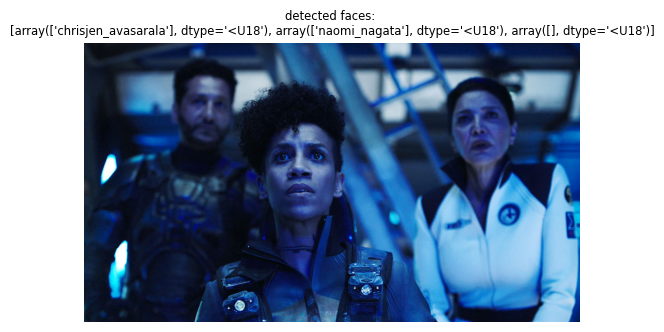

In [137]:
test_img5 = plt.imread('faces/test/unknown_05.jpg')
plt.title('detected faces: \n' + str(test5_results), fontsize='small')
plt.axis('off')
plt.imshow(test_img5)

#### Test Image 6

In [138]:
test6_results = []

for detection in test6_encoding:
    result = face_recognition.compare_faces(trained_images, detection)
    test6_results.append(trained_faces[result])

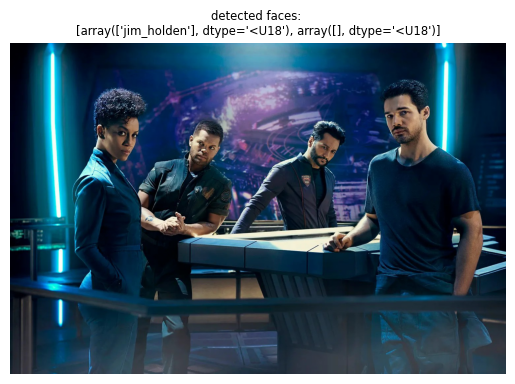

In [139]:
test_img6 = plt.imread('faces/test/unknown_06.jpg')
plt.title('detected faces: \n' + str(test6_results), fontsize='small')
plt.axis('off')
plt.imshow(test_img6)

## Detect Face Location (GPU + Batch Processing)

In [31]:
all_training_images = glob('./faces/*.jpg')
len(all_training_images)

60

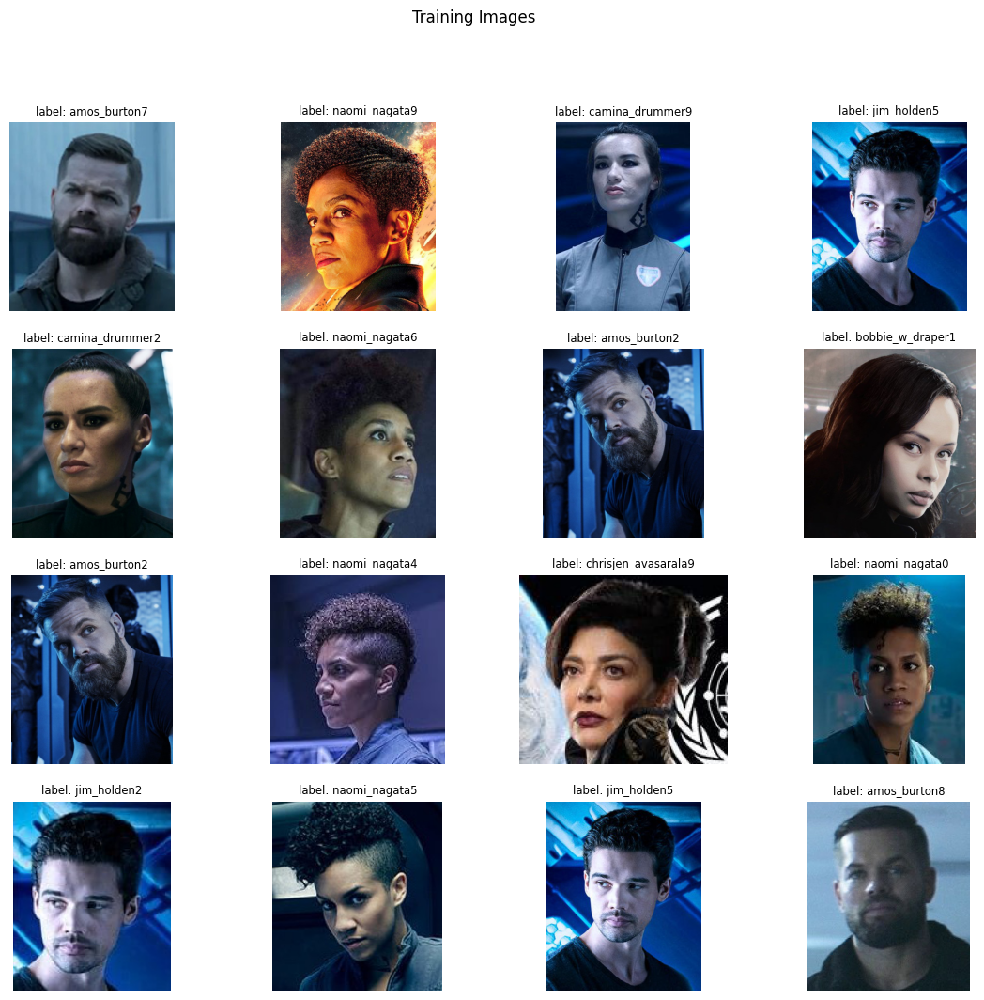

In [32]:
ran_gen = np.random.default_rng()

plt.figure(figsize=(14, 12))
plt.suptitle('Training Images')

for i in range(16):
    ax = plt.subplot(4, 4, i+1)
    random_index = ran_gen.integers(low=0, high=59, size=1)
    i = random_index[0]
    img_loc = all_training_images[i]
    img_title = 'label: ' + all_training_images[i][8:-4]
    image = plt.imread(img_loc)
    plt.imshow(image)
    plt.title(img_title, fontsize='small')
    plt.axis(False)

For this experiment I collected 10 images from all faces that I used before. All training images only contain one face - so I expect only getting one location that I can map to the image label:

In [134]:
image_labels = []
face_locations = []

for image_path in all_training_images:
    image_labels.append(image_path[8:-5])
    image = face_recognition.load_image_file(image_path)
    location = face_recognition.face_locations(image, model="cnn")
    face_locations.append(location)

In [135]:
print(len(image_labels), len(face_locations))

60 60


Now I can get the feature vector for every detected face by it's bounding box:

In [136]:
face_encodings = []
i = 0

for location in face_locations:
    image = face_recognition.load_image_file(all_training_images[i])
    encoding = face_recognition.face_encodings(image, location)[0]

    face_encodings.append(encoding)
    i+=1

In [137]:
len(face_encodings)

60

In [88]:
testcnn1_results = []

for detection in test1_encoding:
    result = face_recognition.compare_faces(face_encodings, detection)
    testcnn1_results.append(np.array(image_labels)[result])

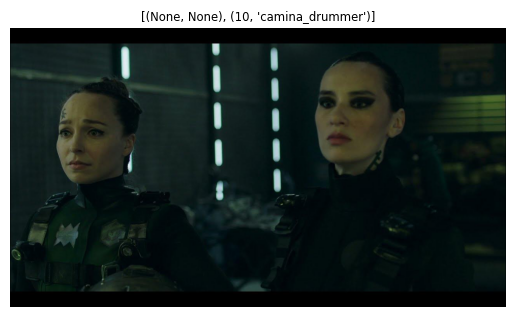

In [94]:
classes = []

test_img1 = plt.imread('faces/test/unknown_01.jpg')

for result in testcnn1_results:
    label, count = np.unique(result, return_counts=True)
    classes.append(
        (
            # check for unlabeled faces
            count[0] if 0 < len(count) else None, 
            label[0] if 0 < len(label) else None
        )
    )
    
plt.title(str(classes), fontsize='small')
plt.axis('off')
plt.imshow(test_img1)

In [76]:
testcnn2_results = []

for detection in test2_encoding:
    result = face_recognition.compare_faces(face_encodings, detection)
    testcnn2_results.append(np.array(image_labels)[result])

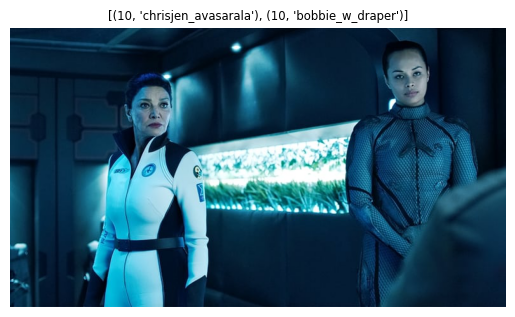

In [95]:
classes = []

test_img2 = plt.imread('faces/test/unknown_02.jpg')

for result in testcnn2_results:
    label, count = np.unique(result, return_counts=True)
    classes.append(
        (
            # check for unlabeled faces
            count[0] if 0 < len(count) else None, 
            label[0] if 0 < len(label) else None
        )
    )
    
plt.title(str(classes), fontsize='small')
plt.axis('off')
plt.imshow(test_img2)

In [60]:
testcnn3_results = []

for detection in test3_encoding:
    result = face_recognition.compare_faces(face_encodings, detection)
    testcnn3_results.append(np.array(image_labels)[result])

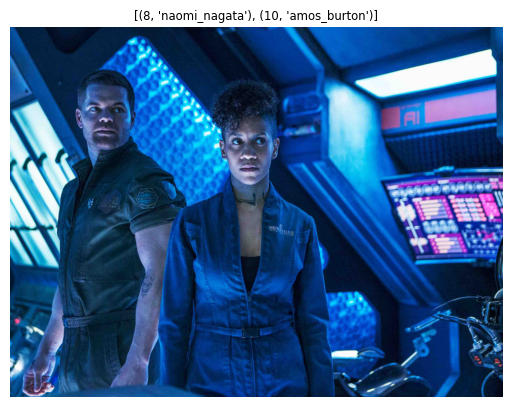

In [96]:
classes = []
test_img3 = plt.imread('faces/test/unknown_03.jpg')

for result in testcnn3_results:
    label, count = np.unique(result, return_counts=True)
    classes.append(
        (
            # check for unlabeled faces
            count[0] if 0 < len(count) else None, 
            label[0] if 0 < len(label) else None
        )
    )
    
plt.title(str(classes), fontsize='small')
plt.axis('off')
plt.imshow(test_img3)

In [98]:
testcnn4_results = []

for detection in test4_encoding:
    result = face_recognition.compare_faces(face_encodings, detection)
    testcnn4_results.append(np.array(image_labels)[result])

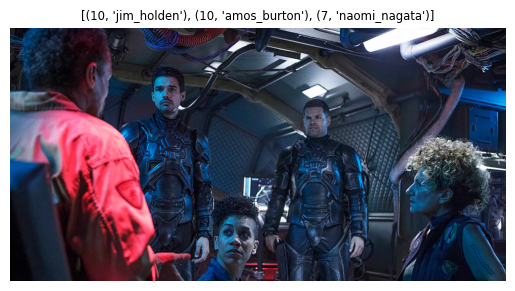

In [99]:
classes = []
test_img4 = plt.imread('faces/test/unknown_04.jpg')

for result in testcnn4_results:
    label, count = np.unique(result, return_counts=True)
    classes.append(
        (
            # check for unlabeled faces
            count[0] if 0 < len(count) else None, 
            label[0] if 0 < len(label) else None
        )
    )
    
plt.title(str(classes), fontsize='small')
plt.axis('off')
plt.imshow(test_img4)

In [100]:
testcnn5_results = []

for detection in test5_encoding:
    result = face_recognition.compare_faces(face_encodings, detection)
    testcnn5_results.append(np.array(image_labels)[result])

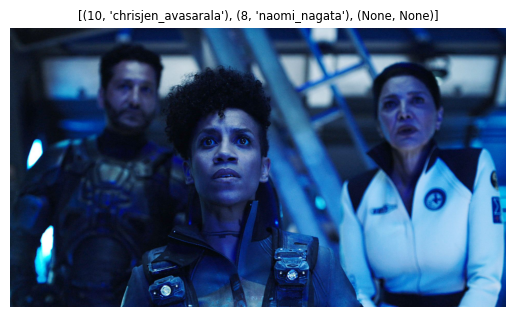

In [101]:
classes = []
test_img5 = plt.imread('faces/test/unknown_05.jpg')

for result in testcnn5_results:
    label, count = np.unique(result, return_counts=True)
    classes.append(
        (
            # check for unlabeled faces
            count[0] if 0 < len(count) else None, 
            label[0] if 0 < len(label) else None
        )
    )
    
plt.title(str(classes), fontsize='small')
plt.axis('off')
plt.imshow(test_img5)

In [102]:
testcnn6_results = []

for detection in test6_encoding:
    result = face_recognition.compare_faces(face_encodings, detection)
    testcnn6_results.append(np.array(image_labels)[result])

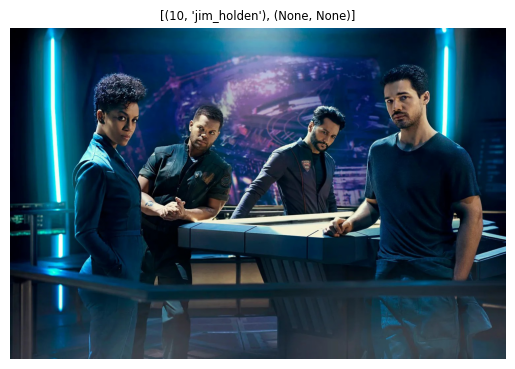

In [103]:
classes = []
test_img6 = plt.imread('faces/test/unknown_06.jpg')

for result in testcnn6_results:
    label, count = np.unique(result, return_counts=True)
    classes.append(
        (
            # check for unlabeled faces
            count[0] if 0 < len(count) else None, 
            label[0] if 0 < len(label) else None
        )
    )
    
plt.title(str(classes), fontsize='small')
plt.axis('off')
plt.imshow(test_img6)

## Draw Bounding Boxes

In [104]:
from PIL import Image, ImageDraw

I'm using the encodings/labels for the 60 training images generated above:

In [139]:
print(len(face_encodings), len(image_labels))

60 60


Load a test image that contains one of the faces above:

In [176]:
unknown_image = face_recognition.load_image_file('faces/test/unknown_01.jpg')

# Find all the faces and face encodings in the unknown image
found_faces = face_recognition.face_locations(unknown_image)
found_face_encodings = face_recognition.face_encodings(unknown_image, found_faces)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
pil_image = Image.fromarray(unknown_image)

/tmp/ipykernel_11211/4178765491.py:25: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/4178765491.py:25: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)


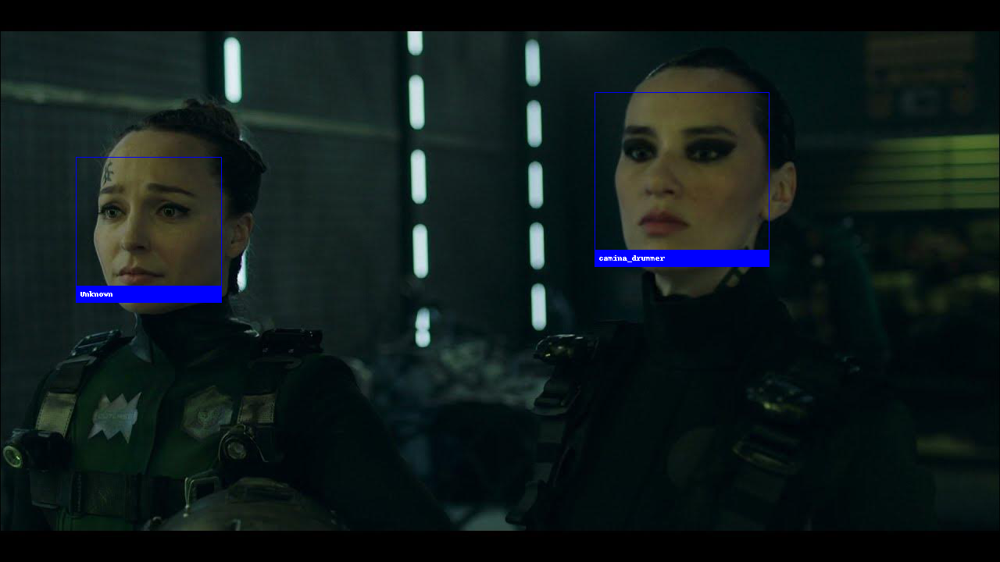

In [177]:
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(found_faces, found_face_encodings):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(face_encodings, face_encoding)

    name = "Unknown"

    # If a match was found in face_encodings, just use the first one.
    # if True in matches:
    #     first_match_index = matches.index(True)
    #     name = image_labels[first_match_index]

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = image_labels[best_match_index]
    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width, text_height = draw.textsize(name)
    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
pil_image.show()

In [144]:
unknown_image2 = face_recognition.load_image_file('faces/test/unknown_02.jpg')

# Find all the faces and face encodings in the unknown image
found_faces2 = face_recognition.face_locations(unknown_image2)
found_face_encodings2 = face_recognition.face_encodings(unknown_image2, found_faces2)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
pil_image2 = Image.fromarray(unknown_image2)

/tmp/ipykernel_11211/1125746434.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/1125746434.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)


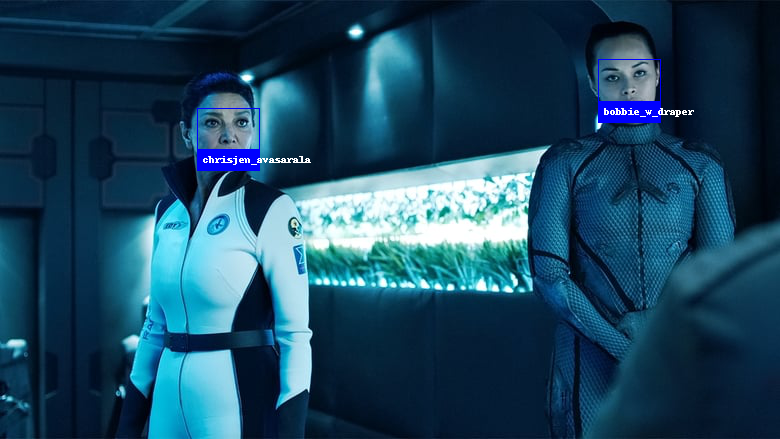

In [145]:
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image2)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(found_faces2, found_face_encodings2):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(face_encodings, face_encoding)

    name = "Unknown"

    # If a match was found in face_encodings, just use the first one.
    # if True in matches:
    #     first_match_index = matches.index(True)
    #     name = image_labels[first_match_index]

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = image_labels[best_match_index]

    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width, text_height = draw.textsize(name)
    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
pil_image2.show()

In [148]:
unknown_image3 = face_recognition.load_image_file('faces/test/unknown_03.jpg')

# Find all the faces and face encodings in the unknown image
found_faces3 = face_recognition.face_locations(unknown_image3)
found_face_encodings3 = face_recognition.face_encodings(unknown_image3, found_faces3)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
pil_image3 = Image.fromarray(unknown_image3)

/tmp/ipykernel_11211/3035399979.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/3035399979.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)


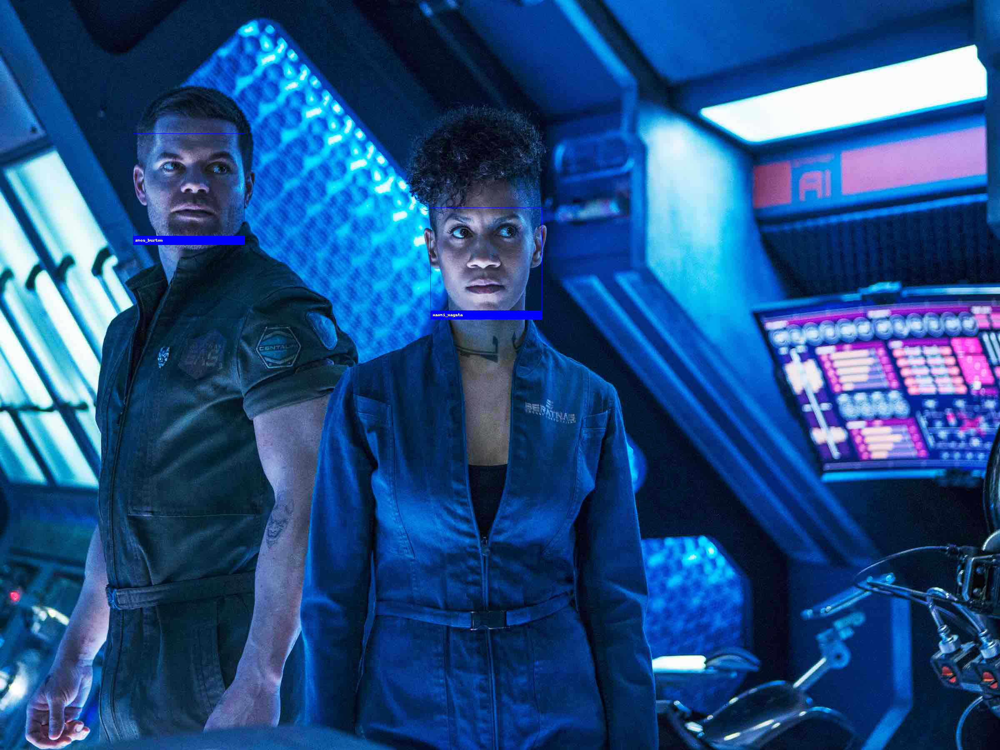

In [149]:
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image3)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(found_faces3, found_face_encodings3):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(face_encodings, face_encoding)

    name = "Unknown"

    # If a match was found in face_encodings, just use the first one.
    # if True in matches:
    #     first_match_index = matches.index(True)
    #     name = image_labels[first_match_index]

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = image_labels[best_match_index]

    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width, text_height = draw.textsize(name)
    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
pil_image3.show()

In [150]:
unknown_image4 = face_recognition.load_image_file('faces/test/unknown_04.jpg')

# Find all the faces and face encodings in the unknown image
found_faces4 = face_recognition.face_locations(unknown_image4)
found_face_encodings4 = face_recognition.face_encodings(unknown_image4, found_faces4)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
pil_image4 = Image.fromarray(unknown_image4)

/tmp/ipykernel_11211/329699440.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/329699440.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/329699440.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)


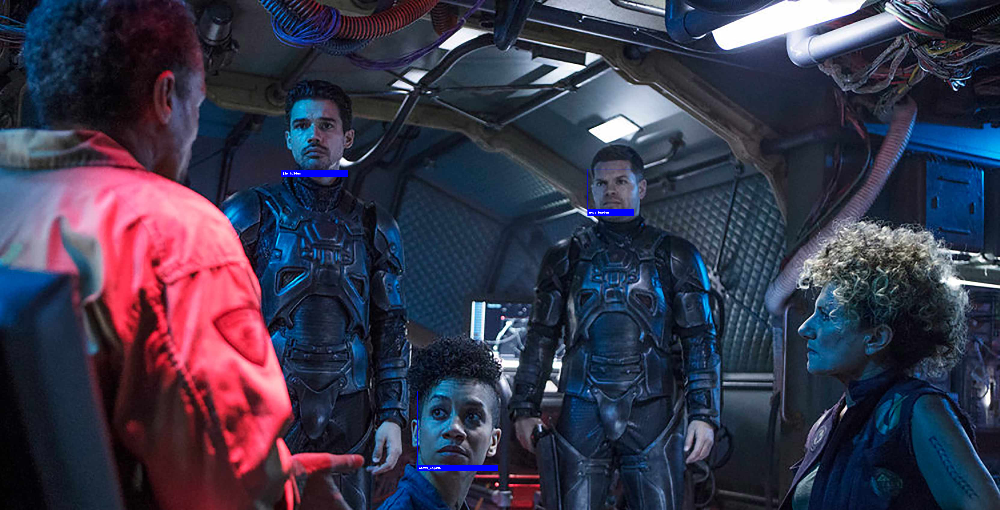

In [151]:
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image4)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(found_faces4, found_face_encodings4):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(face_encodings, face_encoding)

    name = "Unknown"

    # If a match was found in face_encodings, just use the first one.
    # if True in matches:
    #     first_match_index = matches.index(True)
    #     name = image_labels[first_match_index]

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = image_labels[best_match_index]

    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width, text_height = draw.textsize(name)
    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
pil_image4.show()

In [152]:
unknown_image5 = face_recognition.load_image_file('faces/test/unknown_05.jpg')

# Find all the faces and face encodings in the unknown image
found_faces5 = face_recognition.face_locations(unknown_image5)
found_face_encodings5 = face_recognition.face_encodings(unknown_image5, found_faces5)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
pil_image5 = Image.fromarray(unknown_image5)

/tmp/ipykernel_11211/864981556.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/864981556.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/864981556.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)


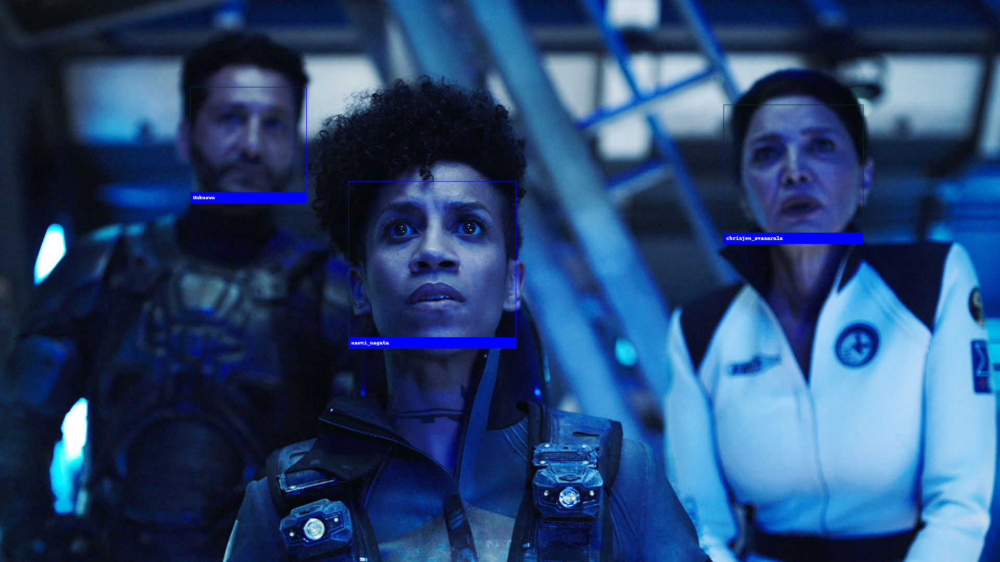

In [153]:
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image5)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(found_faces5, found_face_encodings5):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(face_encodings, face_encoding)

    name = "Unknown"

    # If a match was found in face_encodings, just use the first one.
    # if True in matches:
    #     first_match_index = matches.index(True)
    #     name = image_labels[first_match_index]

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = image_labels[best_match_index]

    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width, text_height = draw.textsize(name)
    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
pil_image5.show()

In [178]:
unknown_image6 = face_recognition.load_image_file('faces/test/unknown_06.jpg')

# Find all the faces and face encodings in the unknown image
found_faces6 = face_recognition.face_locations(unknown_image6)
found_face_encodings6 = face_recognition.face_encodings(unknown_image6, found_faces6)

# Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
pil_image6 = Image.fromarray(unknown_image6)

/tmp/ipykernel_11211/1615432601.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)
/tmp/ipykernel_11211/1615432601.py:26: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(name)


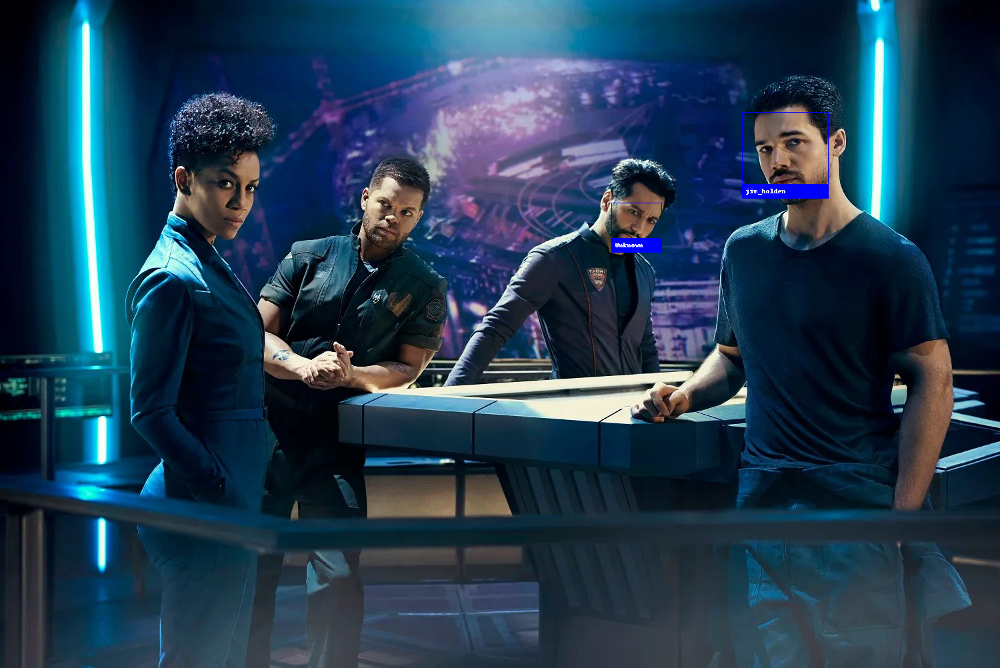

In [179]:
# Create a Pillow ImageDraw Draw instance to draw with
draw = ImageDraw.Draw(pil_image6)

# Loop through each face found in the unknown image
for (top, right, bottom, left), face_encoding in zip(found_faces6, found_face_encodings6):
    # See if the face is a match for the known face(s)
    matches = face_recognition.compare_faces(face_encodings, face_encoding)

    name = "Unknown"

    # If a match was found in face_encodings, just use the first one.
    # if True in matches:
    #     first_match_index = matches.index(True)
    #     name = image_labels[first_match_index]

    # Or instead, use the known face with the smallest distance to the new face
    face_distances = face_recognition.face_distance(face_encodings, face_encoding)
    best_match_index = np.argmin(face_distances)
    if matches[best_match_index]:
        name = image_labels[best_match_index]

    # Draw a box around the face using the Pillow module
    draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

    # Draw a label with a name below the face
    text_width, text_height = draw.textsize(name)
    draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
    draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


# Remove the drawing library from memory as per the Pillow docs
del draw

# Display the resulting image
pil_image6.show()

## Save Feature Vector

Export encodings and labels to use them in a Flask App -> see `./main.py`

In [180]:
with open('features/face_encodings.npy', 'wb') as f:
    np.save(f, face_encodings)

with open('features/image_labels.npy', 'wb') as f:
    np.save(f, image_labels)

In [181]:
with open('features/face_encodings.npy', 'rb') as f:
    feature_vectors = np.load(f)

with open('features/image_labels.npy', 'rb') as f:
    feature_labels = np.load(f)

In [184]:
np.unique(feature_labels, return_counts=True)

(array(['amos_burton', 'bobbie_w_draper', 'camina_drummer',
        'chrisjen_avasarala', 'jim_holden', 'naomi_nagata'], dtype='<U18'),
 array([10, 10, 10, 10, 10, 10]))

In [186]:
feature_vectors.shape

(60, 128)